# INFORMACIÓN DEL PROYECTO DE MACHINE LEARNING

## TÍTULO

##### **PREDICCIÓN DE LA CALIDAD DEL VINO BLANCO EN FUNCIÓN DE DIVERSOS FACTORES DE COMPOSICIÓN**

## DATASET Y OBTENCIÓN DE LOS DATOS

He encontrado en la plataforma de [Kaggle](https://www.kaggle.com/), un dataset muy completo en el que puedo aplicar los conocimientos adquiridos en este bloque de contenido dedicado al *Machine Learning*. La base de datos es la siguiente:

In [1]:
import pandas as pd
import numpy as np
import pandas_profiling as pp
import seaborn as sns
import matplotlib.pyplot as plt

c:\Users\vsuar\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:3: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


In [2]:
heat = pd.read_csv('../data/raw/Heat_Stroke.csv')
heat

,Daily Ingested Water (L),Time of year (month),Cardiovascular disease history,Dehydration,Heat Index (HI),Diastolic BP,Environmental temperature (C),Sickle Cell Trait (SCT),Systolic BP,Weight (kg),...,Heart / Pulse rate (b/min),Age,Sweating,"Skin color (flushed/normal=1, pale=0.5, cyatonic=0)",Strenuous exercise,Nationality,Sex,Hot/dry skin,Time of day,Heat stroke
0,2.821588,7.000000,0,0,107.296910,20.000000,39.000000,0,60.000000,48.364079,...,166.000000,38.000000,0,0.021014,0.500000,1,1,0,10.550628,1
1,5.000000,6.841842,0,0,105.410610,90.000000,37.700000,0,120.000000,52.413863,...,68.000000,50.000000,1,0.045987,0.000000,1,0,0,10.613669,1
2,5.000000,4.636197,0,0,101.823065,50.000000,37.700000,0,100.000000,46.344503,...,96.000000,64.000000,0,0.031299,0.000000,1,0,0,14.419615,1
3,10.500000,2.589828,0,0,95.925389,78.000000,37.700000,0,116.000000,42.132476,...,70.000000,19.000000,0,0.052654,0.000000,1,0,0,9.467515,1
4,5.000000,9.914389,0,0,101.673016,88.000000,37.700000,0,130.000000,41.856694,...,88.000000,21.000000,1,0.076099,0.000000,1,0,0,12.460315,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
604,2.625332,11.808261,0,0,69.444843,82.705255,28.276056,0,117.025213,45.173841,...,106.868166,28.952569,1,0.060595,0.038827,1,1,0,16.994422,0
605,1.069333,7.369952,0,0,67.273039,83.822981,26.008688,0,116.654793,53.125129,...,93.713145,52.733157,1,0.031162,0.657076,0,1,0,12.034963,0
606,1.085594,6.955786,0,0,53.017902,85.101995,32.863125,0,112.713272,47.898687,...,143.858902,21.496651,0,0.015298,0.260901,0,0,0,16.545827,0
607,5.916055,2.741906,0,0,78.665639,88.765944,22.353665,0,111.962413,52.487889,...,181.952819,26.420689,0,0.050419,0.305553,1,0,0,16.757862,0


In [4]:
heat.columns

Index(['Daily Ingested Water (L)', 'Time of year (month)',
       'Cardiovascular disease history', 'Dehydration', 'Heat Index (HI)',
       'Diastolic BP', 'Environmental temperature (C)',
       'Sickle Cell Trait (SCT)', 'Systolic BP', 'Weight (kg)',
       'Patient temperature', 'Rectal temperature (deg C)',
       'Relative Humidity', 'Exposure to sun', 'BMI',
       'Exertional (1) vs classic (0)', 'Barometric Pressure',
       'Heart / Pulse rate (b/min)', 'Age', 'Sweating',
       'Skin color (flushed/normal=1, pale=0.5, cyatonic=0)',
       'Strenuous exercise', 'Nationality', 'Sex', 'Hot/dry skin',
       'Time of day', 'Heat stroke'],
      dtype='object')

In [3]:
heat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 609 entries, 0 to 608
Data columns (total 27 columns):
 #   Column                                               Non-Null Count  Dtype  
---  ------                                               --------------  -----  
 0   Daily Ingested Water (L)                             609 non-null    float64
 1   Time of year (month)                                 609 non-null    float64
 2   Cardiovascular disease history                       609 non-null    int64  
 3   Dehydration                                          609 non-null    int64  
 4   Heat Index (HI)                                      609 non-null    float64
 5   Diastolic BP                                         609 non-null    float64
 6   Environmental temperature (C)                        609 non-null    float64
 7   Sickle Cell Trait (SCT)                              609 non-null    int64  
 8   Systolic BP                                          609 non-null    f

In [4]:
heat.describe()

,Daily Ingested Water (L),Time of year (month),Cardiovascular disease history,Dehydration,Heat Index (HI),Diastolic BP,Environmental temperature (C),Sickle Cell Trait (SCT),Systolic BP,Weight (kg),...,Heart / Pulse rate (b/min),Age,Sweating,"Skin color (flushed/normal=1, pale=0.5, cyatonic=0)",Strenuous exercise,Nationality,Sex,Hot/dry skin,Time of day,Heat stroke
count,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,...,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000,609.000000
mean,3.520119,6.091975,0.047619,0.001642,84.497405,81.235813,31.277937,0.003284,114.323615,47.751283,...,120.420787,41.129276,0.441708,0.082874,0.388117,0.563218,0.515599,0.077176,12.819241,0.178982
std,1.443838,3.471044,0.213134,0.040522,16.266051,13.365608,5.706509,0.057260,15.319954,5.548351,...,27.761283,14.501809,0.496999,0.182378,0.292983,0.496395,0.500167,0.267089,2.270532,0.383652
min,1.005512,0.003924,0.000000,0.000000,31.859605,0.000000,14.133432,0.000000,0.000000,41.279030,...,41.647529,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.002272,0.000000
25%,2.335941,3.003778,0.000000,0.000000,73.005260,81.388233,27.459657,0.000000,111.899424,44.442865,...,102.851595,28.676784,0.000000,0.023166,0.111133,0.000000,0.000000,0.000000,10.928394,0.000000
50%,3.501037,6.440839,0.000000,0.000000,83.461479,84.166226,31.157351,0.000000,114.590011,47.647350,...,121.439809,40.462594,0.000000,0.049303,0.377109,1.000000,1.000000,0.000000,12.773230,0.000000
75%,4.749776,9.051857,0.000000,0.000000,98.687987,87.080987,35.509664,0.000000,117.393279,50.594373,...,136.587402,51.379236,1.000000,0.073178,0.639184,1.000000,1.000000,0.000000,14.657338,0.000000
max,10.500000,11.977820,1.000000,1.000000,122.749205,116.000000,44.271485,1.000000,219.000000,151.953000,...,210.290132,90.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,17.000000,1.000000


Al desplegar la base de datos, me doy cuenta de que la columna *target* (que es la denominada *quality*), lleva una clasificación de números enteros. Así que voy a sacar los valores únicos para ver de qué se componen estos números.

In [6]:
heat['Heat stroke'].unique()

array([1, 0], dtype=int64)

Parece ser que se trata una clasificación que va del 3 al 9. El resto de las columnas está compuesto de datos con valores de tipo decimal.

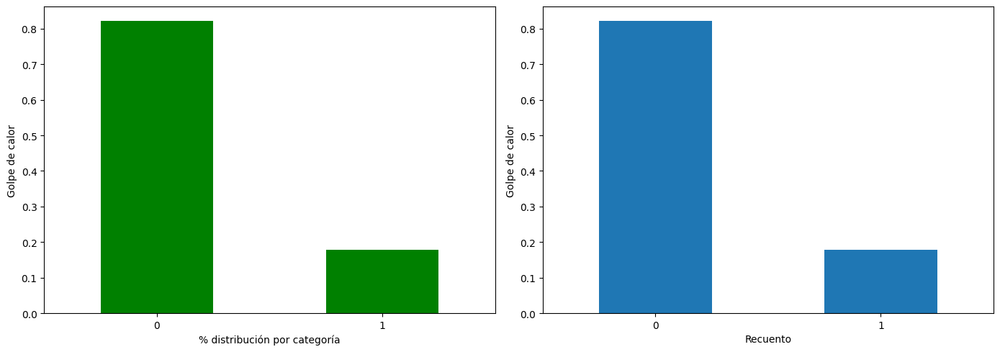

In [8]:
plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
heat['Heat stroke'].value_counts(normalize=True).plot.bar(rot=0, color='green')
plt.ylabel('Golpe de calor')
plt.xlabel('% distribución por categoría')
plt.subplot(1,2,2)
heat['Heat stroke'].value_counts(normalize=True).plot.bar(rot=0)
plt.ylabel('Golpe de calor')
plt.xlabel('Recuento')
plt.tight_layout()
plt.show()

Se ve que los vinos de calidad 6 son los que más salen representados. A la izquierda, se ve que representan más del 40 % del dataset. A la derecha, son más de 2000 vinos.

También se aprecia que el dataset no está bien distribuido, lo que puede influir negativamente en el desempeño del modelo de ML.

Además, como los datos son fundamentalmente numéricos y, por lo tanto, no los podemos clasificar en categorías, vamos a transformarlos en categorías a partir de la columna de alcohol a ver si nos ayuda con nuestro análisis.

Parece que no hay ningún vino con poco alcohol y que tenga calidad. En general se ve que a mayor tasa de alcohol, mayor será la calidad del vino.

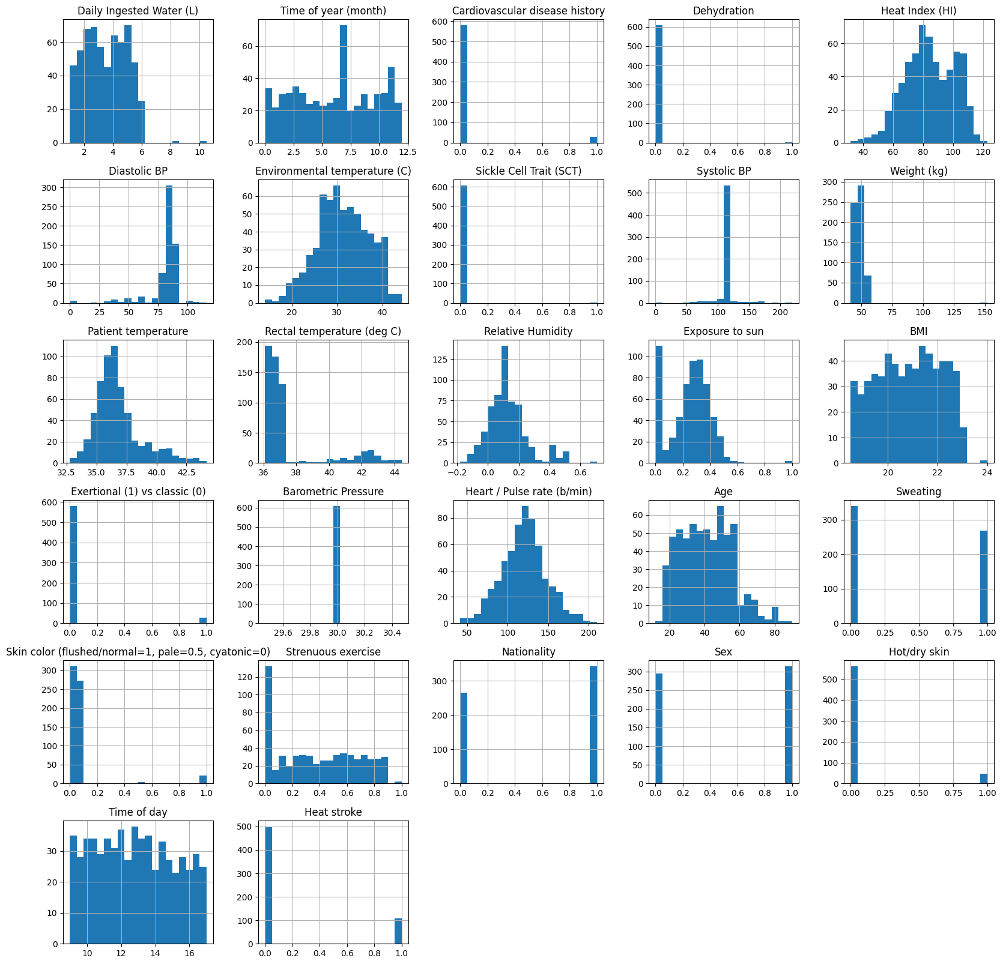

In [11]:
heat.hist(bins=20, figsize=(20, 20))
plt.show()

<Figure size 1800x4000 with 0 Axes>

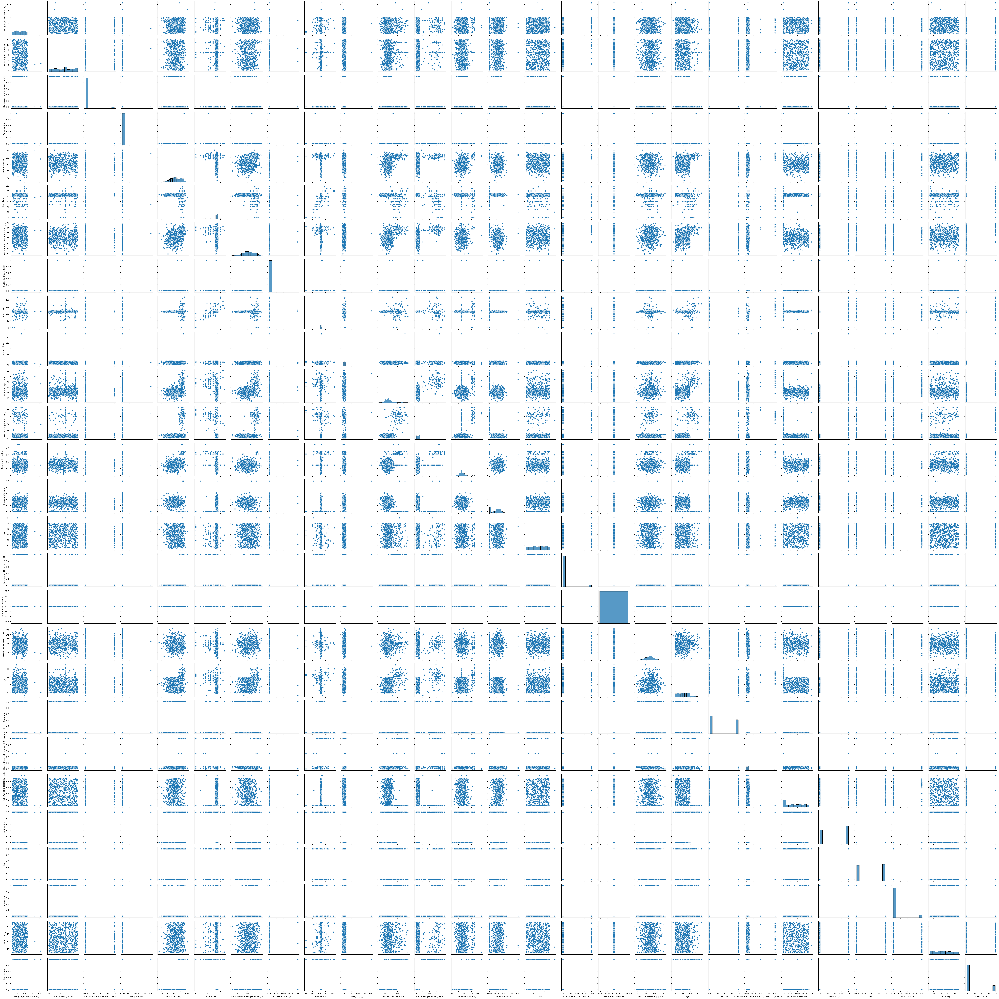

In [12]:
plt.figure(figsize=(18,40))
sns.pairplot(heat)
plt.tight_layout() 
plt.show()

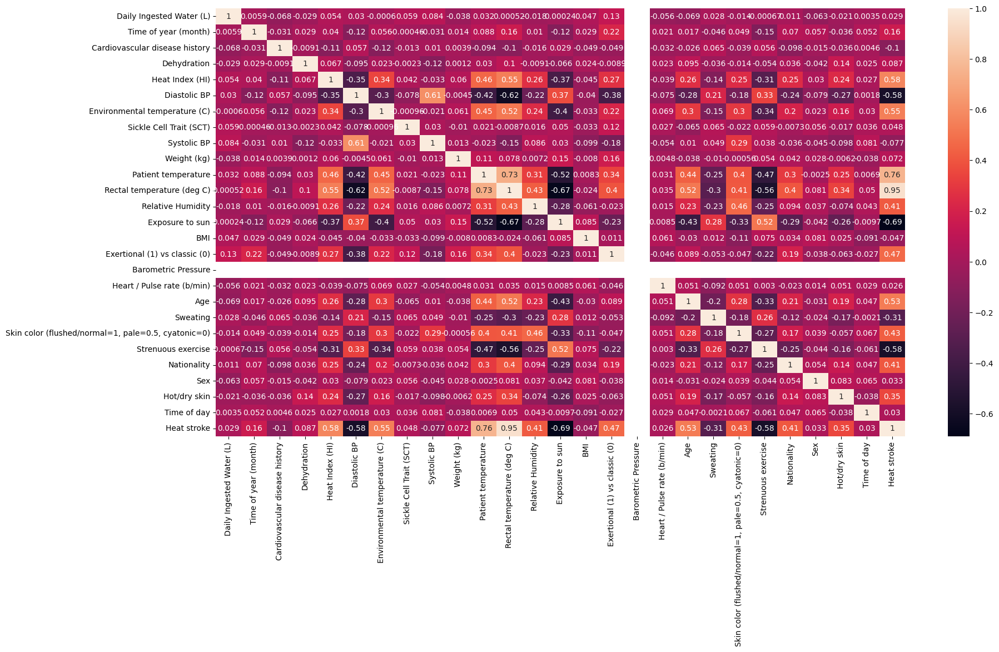

In [13]:
plt.figure(figsize=(20,10))
sns.heatmap(heat.corr(), annot=True);

In [5]:
heat.corrwith(heat['Heat stroke']).abs().sort_values(ascending=False)[1:]

Rectal temperature (deg C)                             9.509282e-01
Patient temperature                                    7.615098e-01
Exposure to sun                                        6.901821e-01
Diastolic BP                                           5.838261e-01
Strenuous exercise                                     5.824399e-01
Heat Index (HI)                                        5.759854e-01
Environmental temperature (C)                          5.454070e-01
Age                                                    5.317375e-01
Exertional (1) vs classic (0)                          4.701784e-01
Skin color (flushed/normal=1, pale=0.5, cyatonic=0)    4.305444e-01
Relative Humidity                                      4.138129e-01
Nationality                                            4.111706e-01
Hot/dry skin                                           3.465065e-01
Sweating                                               3.117923e-01
Time of year (month)                            

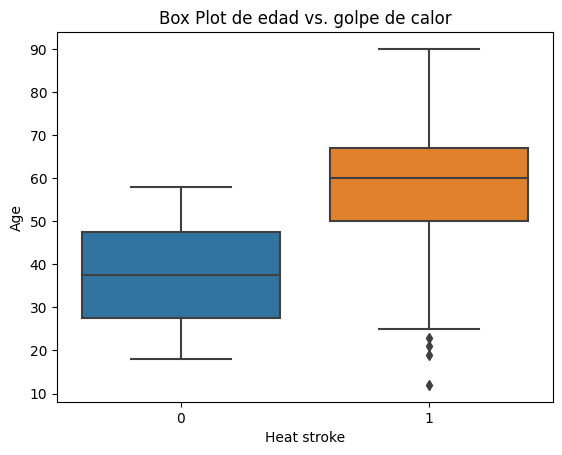

In [16]:
sns.boxplot(x=heat['Heat stroke'], y=heat.Age)
plt.title("Box Plot de edad vs. golpe de calor")
plt.show()

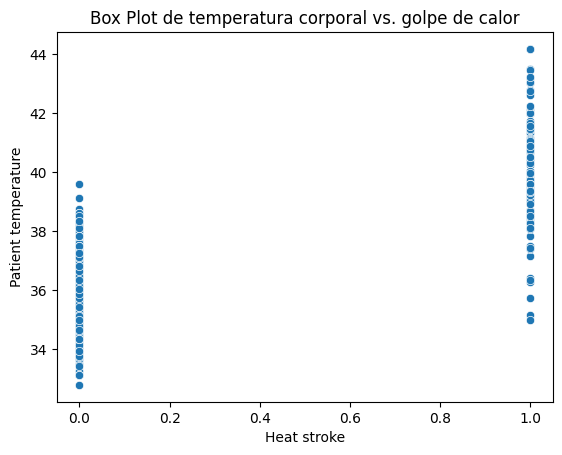

In [11]:
sns.scatterplot(x=heat['Heat stroke'], y=heat['Patient temperature'])
plt.title("Box Plot de temperatura corporal vs. golpe de calor")
plt.show()

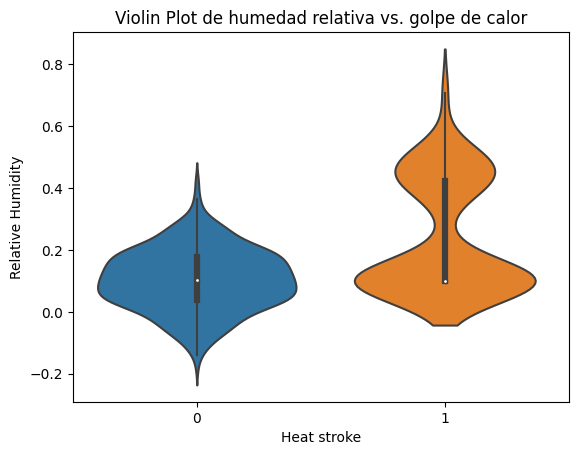

In [17]:
sns.violinplot(x=heat['Heat stroke'], y=heat['Relative Humidity'])
plt.title("Violin Plot de humedad relativa vs. golpe de calor")
plt.show()

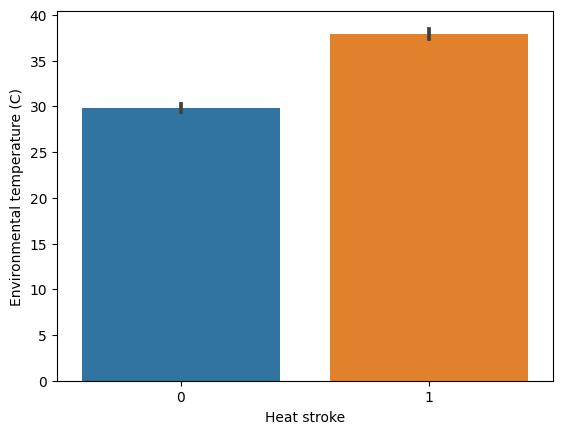

In [23]:
sns.barplot(x='Heat stroke', y='Environmental temperature (C)', data=heat)
plt.show()

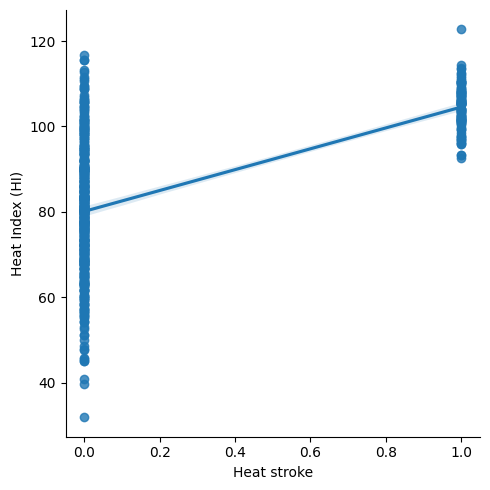

In [24]:
sns.lmplot(x='Heat stroke', y='Heat Index (HI)', data=heat)
plt.show()

In [3]:
heat.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]